## TRAIN

## DATA PREPROCESSING

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('train.csv')

In [3]:
df.head()

,PassengerId,HomePlanet,CryoSleep,Cabin,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Name,Transported
0,0001_01,Europa,False,B/0/P,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,Maham Ofracculy,False
1,0002_01,Earth,False,F/0/S,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,Juanna Vines,True
2,0003_01,Europa,False,A/0/S,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,Altark Susent,False
3,0003_02,Europa,False,A/0/S,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,Solam Susent,False
4,0004_01,Earth,False,F/1/S,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,Willy Santantines,True


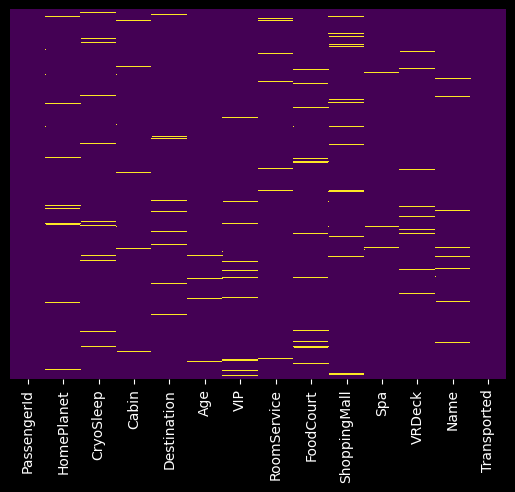

In [4]:
sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap='viridis')

In [5]:
x = df.isnull().sum()

In [6]:
#TAKING CARE OF THE MISSING AND CATEGORICAL VALUES
#MEDIAN
df['Age']=df['Age'].fillna(df['Age'].median())

#MODE
df['HomePlanet']=df['HomePlanet'].fillna(df['HomePlanet'].mode()[0])
df['CryoSleep']=df['CryoSleep'].fillna(df['CryoSleep'].mode()[0])
df['Destination']=df['Destination'].fillna(df['Destination'].mode()[0])
df['RoomService']=df['RoomService'].fillna(df['RoomService'].mode()[0])
df['FoodCourt']=df['FoodCourt'].fillna(df['FoodCourt'].mode()[0])
df['ShoppingMall']=df['ShoppingMall'].fillna(df['ShoppingMall'].mode()[0])
df['Spa']=df['Spa'].fillna(df['Spa'].mode()[0])
df['VRDeck']=df['VRDeck'].fillna(df['VRDeck'].mode()[0])
df['VIP']=df['VIP'].fillna(df['VIP'].mode()[0])

#DROP
df.drop(['Cabin'],axis=1,inplace=True)
df.drop(['Name'],axis=1,inplace=True)
df.drop(['PassengerId'],axis=1,inplace=True)

In [8]:
HomePlanet_dummies = pd.get_dummies(df['HomePlanet'],drop_first=True)
HomePlanet_dummies

,Europa,Mars
0,1,0
1,0,0
2,1,0
3,1,0
4,0,0
...,...,...
8688,1,0
8689,0,0
8690,0,0
8691,1,0


In [12]:
CryoSleep_dummies = pd.get_dummies(df['CryoSleep'],drop_first=True)
CryoSleep_dummies

,True
0,0
1,0
2,0
3,0
4,0
...,...
8688,0
8689,1
8690,0
8691,0


In [17]:
Destination_dummies = pd.get_dummies(df['Destination'],drop_first=True)
Destination_dummies

,PSO J318.5-22,TRAPPIST-1e
0,0,1
1,0,1
2,0,1
3,0,1
4,0,1
...,...,...
8688,0,0
8689,1,0
8690,0,1
8691,0,0


In [18]:
VIP_dummies = pd.get_dummies(df['VIP'],drop_first=True)
VIP_dummies

,True
0,0
1,0
2,1
3,0
4,0
...,...
8688,1
8689,0
8690,0
8691,0


In [19]:
Transported_dummies = pd.get_dummies(df['Transported'],drop_first=True)
Transported_dummies

,True
0,0
1,1
2,0
3,0
4,1
...,...
8688,0
8689,0
8690,1
8691,0


In [20]:
df.head()

,HomePlanet,CryoSleep,Destination,Age,VIP,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Transported
0,Europa,False,TRAPPIST-1e,39.0,False,0.0,0.0,0.0,0.0,0.0,False
1,Earth,False,TRAPPIST-1e,24.0,False,109.0,9.0,25.0,549.0,44.0,True
2,Europa,False,TRAPPIST-1e,58.0,True,43.0,3576.0,0.0,6715.0,49.0,False
3,Europa,False,TRAPPIST-1e,33.0,False,0.0,1283.0,371.0,3329.0,193.0,False
4,Earth,False,TRAPPIST-1e,16.0,False,303.0,70.0,151.0,565.0,2.0,True


In [ ]:
df.drop(['HomePlanet','CryoSleep','Destination','VIP','Transported'],axis=1,inplace=True)

In [23]:
df.head()

,Age,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck
0,39.0,0.0,0.0,0.0,0.0,0.0
1,24.0,109.0,9.0,25.0,549.0,44.0
2,58.0,43.0,3576.0,0.0,6715.0,49.0
3,33.0,0.0,1283.0,371.0,3329.0,193.0
4,16.0,303.0,70.0,151.0,565.0,2.0


In [39]:
df = pd.concat([df,HomePlanet_dummies,CryoSleep_dummies,Destination_dummies,VIP_dummies,Transported_dummies],axis=1)
df.head()

,Age,RoomService,FoodCourt,ShoppingMall,Spa,VRDeck,Europa,Mars,True,PSO J318.5-22,TRAPPIST-1e,True,True,Europa,Mars,True,PSO J318.5-22,TRAPPIST-1e,True,True
0,39.0,0.0,0.0,0.0,0.0,0.0,1,0,0,0,1,0,0,1,0,0,0,1,0,0
1,24.0,109.0,9.0,25.0,549.0,44.0,0,0,0,0,1,0,1,0,0,0,0,1,0,1
2,58.0,43.0,3576.0,0.0,6715.0,49.0,1,0,0,0,1,1,0,1,0,0,0,1,1,0
3,33.0,0.0,1283.0,371.0,3329.0,193.0,1,0,0,0,1,0,0,1,0,0,0,1,0,0
4,16.0,303.0,70.0,151.0,565.0,2.0,0,0,0,0,1,0,1,0,0,0,0,1,0,1


In [45]:
x_train = df.loc['Age':'True'].values
y_train = df.loc[:,'True'].values
#'Age','RoomService','FoodCourt','ShoppingMall','Spa','VRDeck','Europa','Mars','True','PSO J318.5-22','TRAPPIST-1e','True','True','Europa','Mars','True','PSO J318.5-22','TRAPPIST-1e','True'

KeyError: 'True'

In [33]:
x_train

array([[3.900e+01, 0.000e+00, 0.000e+00, ..., 0.000e+00, 1.000e+00,
        0.000e+00],
       [2.400e+01, 1.090e+02, 9.000e+00, ..., 0.000e+00, 1.000e+00,
        0.000e+00],
       [5.800e+01, 4.300e+01, 3.576e+03, ..., 0.000e+00, 1.000e+00,
        1.000e+00],
       ...,
       [2.600e+01, 0.000e+00, 0.000e+00, ..., 0.000e+00, 1.000e+00,
        0.000e+00],
       [3.200e+01, 0.000e+00, 1.049e+03, ..., 0.000e+00, 0.000e+00,
        0.000e+00],
       [4.400e+01, 1.260e+02, 4.688e+03, ..., 0.000e+00, 1.000e+00,
        0.000e+00]])

In [34]:
y_train

array([0, 1, 0, ..., 1, 0, 1], dtype=uint8)

## MODEL SELECTION AND TRAINING 

In [35]:
from sklearn.linear_model import LogisticRegression
classifier = LogisticRegression()
classifier.fit(x_train,y_train)

c:\Users\ViVian\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [37]:
x_test = pd.read_csv('test_outcomes.csv')
print(x_test)

       Age  RoomService  FoodCourt  ShoppingMall     Spa  VRDeck
0     27.0          0.0        0.0           0.0     0.0     0.0
1     19.0          0.0        9.0           0.0  2823.0     0.0
2     31.0          0.0        0.0           0.0     0.0     0.0
3     38.0          0.0     6652.0           0.0   181.0   585.0
4     20.0         10.0        0.0         635.0     0.0     0.0
...    ...          ...        ...           ...     ...     ...
4272  34.0          0.0        0.0           0.0     0.0     0.0
4273  42.0          0.0      847.0          17.0    10.0   144.0
4274  26.0          0.0        0.0           0.0     0.0     0.0
4275  26.0          0.0     2680.0           0.0     0.0   523.0
4276  43.0          0.0        0.0           0.0     0.0     0.0

[4277 rows x 6 columns]


In [38]:
y_pred = classifier.predict(x_test)

c:\Users\ViVian\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but LogisticRegression was fitted without feature names
  warnings.warn(


ValueError: X has 6 features, but LogisticRegression is expecting 12 features as input.

In [ ]:
classifier.predict()